# $\nu_e$  Selection and Calorimetry

Electron neutrinos in LArTPCs are detected by reconstructing the final state topology of the $\nu_e + Ar$ interaction. The target topology will depend on what interaction type or mode you want to include in your study.`


## 1-1. Setup environments

In [1]:
import sys, os
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

SOFTWARE_DIR = '/sdf/group/neutrino/koh0207/spine/' # Change this path to your software install
DATA_DIR = '/sdf/data/neutrino/icarus/spine/prod/bnb_nue_corsika_v89/output_spine2' # Change this path if you are not on SDF (see main README)

# Visualization Tools
import plotly
import plotly.graph_objs as go
from plotly.subplots import make_subplots
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

# Set software directory
sys.path.append(SOFTWARE_DIR)

In [2]:
import yaml

DATA_PATH = os.path.join(DATA_DIR, 'larcv_mc_20240612_034750_196001-6979639f-eac5-4790-a745-7bf39a87f214_spine2.h5') # Replace the source file with the correct path
anaconfig = './anaconfig.cfg'
anaconfig = yaml.safe_load(open(anaconfig, 'r').read().replace('DATA_PATH', DATA_PATH))

print(yaml.dump(anaconfig))

build:
  fragments: false
  interactions: true
  mode: both
  particles: true
  units: cm
io:
  reader:
    file_keys: /sdf/data/neutrino/icarus/spine/prod/bnb_nue_corsika_v89/output_spine2/larcv_mc_20240612_034750_196001-6979639f-eac5-4790-a745-7bf39a87f214_spine2.h5
    name: hdf5



In [3]:
from spine.driver import Driver

driver = Driver(anaconfig)

Welcome to JupyROOT 6.22/08

 ██████████   ██████████    ███   ███       ██   ███████████
███        █  ██       ███   █    █████     ██   ██         
  ████████    ██       ███  ███   ██  ████  ██   ██████████ 
█        ███  ██████████     █    ██     █████   ██         
 ██████████   ██            ███   ██       ███   ███████████

Release version: 0.1.0

$CUDA_VISIBLE_DEVICES=

Configuration processed at: Linux sdfampere002 4.18.0-372.32.1.el8_6.x86_64 #1 SMP Fri Oct 7 12:35:10 EDT 2022 x86_64 x86_64 x86_64 GNU/Linux

base: {seed: 1721904011}
io:
  reader: {name: hdf5, file_keys: /sdf/data/neutrino/icarus/spine/prod/bnb_nue_corsika_v89/output_spine2/larcv_mc_20240612_034750_196001-6979639f-eac5-4790-a745-7bf39a87f214_spine2.h5}
build: {mode: both, units: cm, fragments: false, particles: true, interactions: true}

Will load 1 file(s):
  - /sdf/data/neutrino/icarus/spine/prod/bnb_nue_corsika_v89/output_spine2/larcv_mc_20240612_034750_196001-6979639f-eac5-4790-a745-7bf39a87f214_spine2.h

## 1-2. Example $\nu_e$ event visualization

In [4]:
ENTRY = 5
data = driver.process(entry=ENTRY)

In [5]:
# Retrieving data structures
reco_particles     = data['reco_particles']
truth_particles    = data['truth_particles']
reco_interactions  = data['reco_interactions']
truth_interactions = data['truth_interactions']

In [6]:
from spine.vis.out import Drawer
drawer = Drawer(data, detector='icarus') # Try to replace none with 'icarus', 'sbnd' or '2x2'!

In [7]:
fig = drawer.get('particles', 'pid', draw_end_points=False, draw_vertices=False) # Try to replace 'id' with 'shape'!

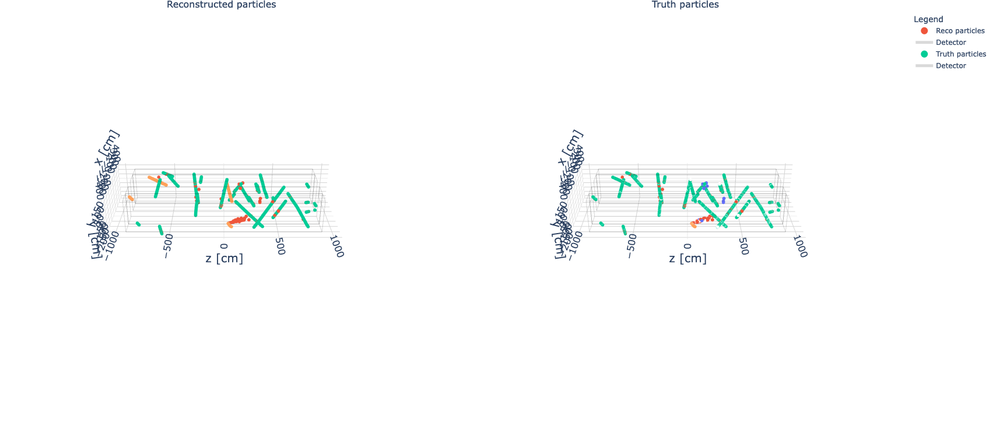

In [8]:
fig.show()

## 1-3. Printing out neutrino interaction information

In [9]:
from spine.utils.globals import NU_CURR_TYPE, NU_INT_TYPE

In [10]:
for ia in data['truth_interactions']:
    if ia.nu_id > -1:
        print(ia)
        print(NU_INT_TYPE[ia.interaction_type], NU_CURR_TYPE[ia.current_type])

TruthInteraction(ID: 22  | Size: 3126  | Topology: 1e1p       | Match: 21 )
----------------------------------------------------------------------
TruthParticle(ID: 22  | PID: Electron | Primary: 1  | Size: 2627  | Match: 1  )
TruthParticle(ID: 23  | PID: Proton   | Primary: 1  | Size: 499   | Match: 42 )
CCQE CC


As you may be already familiar, CCQE refers to charged-current quasi-elastic. 

## 2. The Booster Neutrino Beam

 * The Booster Neutrino Beam (BNB) at Fermilab produces neutrinos using 8.89 GeV momentum Booster synchrotron protons incident on a berylllium target. 
 * $p + Be \to \pi^+, K^+, K^0_L \to \nu_\mu + \mu^+ + ...$
 * In neutrino mode, the flux is dominated by 99.5% $\nu_\mu$ and 0.5% $\nu_e$. 

## 2-1. BNB $\nu_e$ Intrinsic-only

The BNB beam has an intrinsic $\nu_e$ content of ~0.5%. For estimating efficiency of reconstructing $\nu_e$'s, it is desirable to have a $\nu_e$ enriched MC sample to develop selection algorithms. This sample consists of ~150k BNB intrinsice $\nu_e$ interactions embedding in a background of out-of-time cosmic rays. The previous event display is one example. 

Producing the csv files that contain interaction and particle level information for 150k images can be time consuming. Here, I've already ran the csv production script for demonstration purposes. 

In [11]:
path_dir = '/sdf/data/neutrino/koh0207/bnb_nue_corsika/nocut/'
df = pd.read_csv(os.path.join(path_dir, '0', 'interactions_t2r.csv'))
nue_t2r = pd.DataFrame({col: pd.Series(dtype=dtype) for col, dtype in df.dtypes.items()})
nue_r2t = pd.DataFrame({col: pd.Series(dtype=dtype) for col, dtype in df.dtypes.items()})
flist = sorted(os.listdir(path_dir), key=lambda x: eval(x))
for folder_name in flist:
    path_t2r = os.path.join(path_dir, folder_name, 'interactions_t2r.csv')
    path_r2t = os.path.join(path_dir, folder_name, 'interactions_r2t.csv')
    df_t2r = pd.read_csv(path_t2r)
    df_r2t = pd.read_csv(path_r2t)
    nue_t2r = pd.concat([nue_t2r, df_t2r], ignore_index=True)
    nue_r2t = pd.concat([nue_r2t, df_r2t], ignore_index=True)

Each row is a matched interaction pair, where truth information is labeled with the prefix `true` and reco information with `reco`. 

In [12]:
nue_t2r.head()

,Iteration,Index,file_index,interaction_match_overlap,true_interaction_id,true_interaction_size,true_nu_id,true_volume_id,true_num_primary_photons,true_num_primary_electrons,...,reco_fmatched,reco_flash_time,reco_flash_total_pE,reco_flash_id,reco_flash_hypothesis,reco_flash_xoffset,true_e_dedx,pred_e_dedx,true_e_conv_dist,pred_e_conv_dist
0,0,0,0,1.000000,0,1261,-1,0,0,0,...,False,-inf,-1.0,-1,-1.0,-inf,-inf,-inf,-inf,-inf
1,0,0,0,0.999252,1,1337,-1,0,0,0,...,False,-inf,-1.0,-1,-1.0,-inf,-inf,-inf,-inf,-inf
2,0,0,0,0.993997,2,2322,-1,1,0,0,...,False,-inf,-1.0,-1,-1.0,-inf,-inf,-inf,-inf,-inf
3,0,0,0,0.992699,3,5048,-1,1,0,0,...,False,-inf,-1.0,-1,-1.0,-inf,-inf,-inf,-inf,-inf
4,0,0,0,0.997431,4,3106,-1,0,0,0,...,False,-inf,-1.0,-1,-1.0,-inf,-inf,-inf,-inf,-inf


Let's first collect true neutrino interactions only and inspect the contents

In [14]:
df_nues = nue_t2r.query('true_nu_id > -1')

In [16]:
df_nues = nue_t2r.query('true_nu_id > -1')
# Convert numeric labels to strings
df_nues['true_nu_interaction_type'] = df_nues['true_nu_interaction_type'].astype(int).map(NU_INT_TYPE)
df_nues['true_nu_current_type'] = df_nues['true_nu_current_type'].astype(int).map(NU_CURR_TYPE)

We can observe the interaction type subdivision of $\nu_e$ interactions 

In [18]:
df_nues['true_nu_interaction_type'].value_counts(normalize=True)

CCQE                        0.306981
NuanceOffset                0.153486
ResCCNuProtonPiPlus         0.128138
CCDIS                       0.098995
NCQE                        0.075425
ResCCNuNeutronPi0           0.049244
ResCCNuNeutronPiPlus        0.045732
NCDIS                       0.044530
ResNCNuNeutronPi0           0.030671
ResNCNuProtonPi0            0.023922
ResNCNuNeutronPiMinus       0.021089
ResNCNuProtonPiPlus         0.014134
CCCOH                       0.002464
NCCOH                       0.001357
ResNCNuBarNeutronPi0        0.001211
ResNCNuBarProtonPi0         0.000902
ResNCNuBarNeutronPiMinus    0.000799
ResNCNuBarProtonPiPlus      0.000601
NuElectronElastic           0.000318
Name: true_nu_interaction_type, dtype: float64

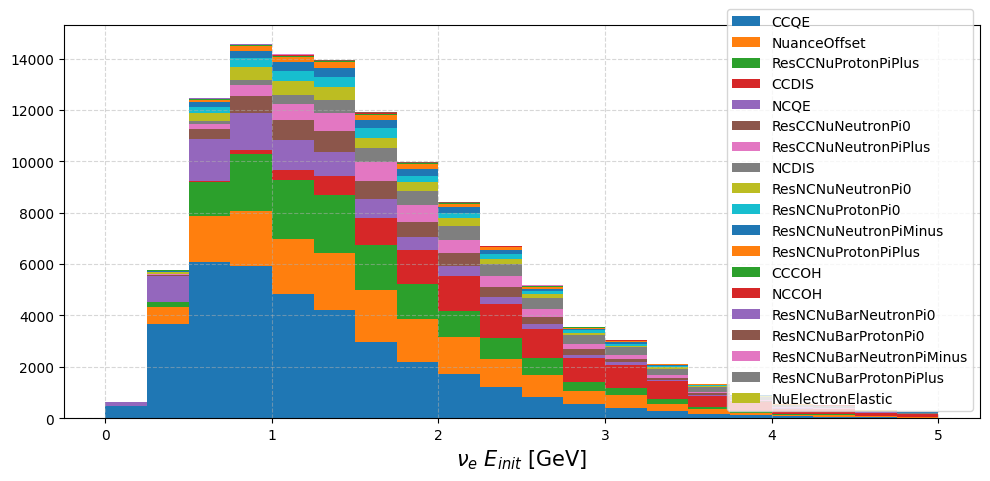

In [19]:
fig, ax = plt.subplots(figsize=(10, 5))
x, label = [], []
ax.grid(linestyle='--', alpha=0.5)
for nu_int_type in dict(df_nues['true_nu_interaction_type'].value_counts()):
    x.append(df_nues.query(f'true_nu_interaction_type == "{nu_int_type}"')['true_nu_energy_init'])
    label.append(nu_int_type)
ax.hist(x, range=(0, 5), bins=20, stacked=True, label=label)
ax.set_xlabel('$\\nu_e$ $E_{init}$ [GeV]', fontsize=15)
ax.legend(fontsize=10)
fig.tight_layout()

### 2-1-1. Defining the signal

The first step in performing selection is to define the signal. Here, I use five selection cuts:
 * Containment Cut: require particles participating in the candidate interaction to be within some magin from detector boundaries.
 * Fiducial Cut: require reconstructed interaction vertex to be within fiducial volume. 
 * Reco Flash Cut: require interactions to be in-time with the beam trigger window. The timing information is provided from the PMTs, and the process of matching PMT information with TPC spacepoints is called flash-matching.
 * Final State Topology Cut: select candidate signal interaction by requiring one primary electron and at least one primary proton. 
 
For this tutorial, we will look for interactions with $1eNp$ (one electron, 1 or more proton) topology with $N \geq 1$.

In [20]:
# Helper functions for managing different cuts. 
from cuts import *

In [21]:
manager = SelectionManager(nue_t2r, nue_r2t)

In [43]:
class FinalStateTopologyCut(Cut):
    
    name = 'final_state_topology_cut'
    _use_particles = False
    
    def __init__(self):
        super(FinalStateTopologyCut, self).__init__()
            
    def __call__(self, ia, mode):
        if mode == 'true':
            out = (ia.true_num_primary_electrons == 1) and \
                (ia.true_num_primary_protons >= 1) and \
                (ia.true_num_primary_photons == 0) and \
                (ia.true_num_primary_muons == 0) and \
                (ia.true_num_primary_pions == 0)
        elif mode == 'reco':
            out = (ia.reco_num_primary_electrons == 1) and \
                (ia.reco_num_primary_protons >= 1) and \
                (ia.reco_num_primary_photons == 0) and \
                (ia.reco_num_primary_muons == 0) and \
                (ia.reco_num_primary_pions == 0)
        else:
            raise ValueError('Invalid mode')
        return out

In [22]:
filter_list = [TruthNeutrinoCut(pdg_code=12), 
               ContainmentCut(),
               FiducialCut(), 
               RecoFlashCut(),
               FinalStateTopologyCut()]
for f in filter_list:
    manager.register_filter(f)

In [23]:
manager.process()

  0%|          | 0/4732191 [00:00<?, ?it/s]

  0%|          | 0/3638570 [00:00<?, ?it/s]

In [24]:
out = manager.evaluate()

In [25]:
for c in out:
    print(f"Name: {c[0]:<30} Eff = {c[1] * 100:>8.4f}, Pur = {c[3] * 100:>8.4f}  n_truth = {c[2]:>6}, n_reco = {c[4]:>6}")

Name: truth_neutrino_cut             Eff = 100.0000, Pur =   0.5049  n_truth = 21358 / 21358, n_reco = 23891 / 4732191
Name: containment_cut                Eff =  93.4123, Pur =   7.2594  n_truth = 19951 / 21358, n_reco = 22619 / 311583
Name: fiducial_cut                   Eff =  92.9675, Pur =  11.5274  n_truth = 19856 / 21358, n_reco = 21743 / 188620
Name: reco_flash_cut                 Eff =  91.6472, Pur =  34.9263  n_truth = 19574 / 21358, n_reco = 19404 / 55557
Name: final_state_topology_cut       Eff =  59.6685, Pur =  86.2338  n_truth = 12744 / 21358, n_reco = 12616 / 14630


In [27]:
# Function to clean csv table for use in selection confusion matrix. 
from plotting import make_table

In [28]:
df_plot, truth_labels, reco_labels = make_table(nue_t2r, manager.true_def_t2r[-1].astype(bool), manager.reco_def_t2r[-1].astype(bool))
df_plot2, truth_labels2, reco_labels2 = make_table(nue_r2t, manager.true_def_r2t[-1].astype(bool), manager.reco_def_r2t[-1].astype(bool))

In [29]:
from sklearn.metrics import confusion_matrix
from spine.vis.evaluation import heatmap, annotate_heatmap

def make_confusion_matrix(df_plot, truth_name='Truth', pred_name='Prediction', normalize='true', ax=None):
    
    labels     = sorted(set(list(df_plot[truth_name].unique()) + list(df_plot[pred_name].unique())))
    row_labels = sorted(set(list(df_plot[truth_name].unique())))
    col_labels = sorted(set(list(df_plot[pred_name].unique())))
    
    cm = confusion_matrix(df_plot[truth_name], df_plot[pred_name], normalize=normalize, labels=labels)
    cm_counts = confusion_matrix(df_plot[truth_name], df_plot[pred_name], labels=labels)
    
    cm = cm[:, np.where(cm.sum(axis=0) > 0)[0]]
    cm_counts = cm_counts[:, np.where(cm_counts.sum(axis=0) > 0)[0]]

    cm = cm[np.where(cm.sum(axis=1) > 0)[0], :]
    cm_counts = cm_counts[np.where(cm_counts.sum(axis=1) > 0)[0], :]
    
    im = heatmap(cm.T * 100, 
             col_labels, 
             row_labels, 
             ax=ax, cmap="Blues")
    
    texts = annotate_heatmap(im, unc=cm_counts.T, valfmt="{:.2f}% \n({})", fontsize=15)
    
    return im, texts, (row_labels, col_labels), cm, cm_counts

In [30]:
row_labels = []
col_labels = []

for key, val in sorted(df_plot['Truth'].value_counts().items()):
    row_labels.append(truth_labels[key])
    
for key, val in sorted(df_plot['Prediction'].value_counts().items()):
    col_labels.append(reco_labels[key])

Plot the confusion matrix for selection. We will divide the truth labels into Cosmics, $\nu_e$ 1eNp, $\nu_e$ CC (other), and $\nu_e$ NC. 

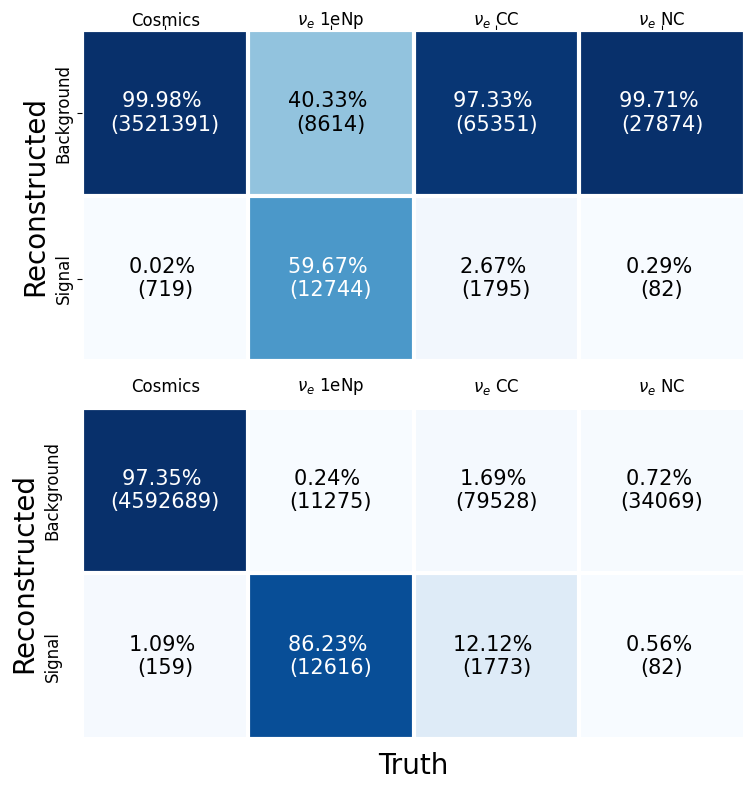

In [31]:
fig, ax = plt.subplots(2, 1, figsize=(12, 8))
im1, text1, _, _, _ = make_confusion_matrix(df_plot, ax=ax[0])
ax[0].set_ylabel('Reconstructed', fontsize=20)
ax[1].set_xlabel('Truth', fontsize=20)
ax[0].set_yticklabels(col_labels, fontsize=12, va='center', rotation=90)
ax[0].set_xticklabels(row_labels, fontsize=12, va='center', rotation =0)

im2, text2, _, _, _ = make_confusion_matrix(df_plot2, ax=ax[1], normalize='pred')
ax[1].set_ylabel('Reconstructed', fontsize=20)
ax[1].set_yticklabels(col_labels, fontsize=12, va='center', rotation=90)
ax[1].set_xticklabels(row_labels, fontsize=12, va='center', rotation =0)

ax[1].tick_params(axis='both', length=0, pad=15)
fig.tight_layout()
# fig.savefig(os.path.join(PLOT_DIR, 'num_final_nocut.pdf'))

## 3-1. BNB $\nu$ + Cosmics

This sample is a ~300k BNB beam simulation with out-of-time cosmics, where the beam content is 99.5% $\nu_\mu$ and 0.5% $\nu_e$. In particular, in constrast to the $\nu_e$ intrinsic only sample, there will be significant background contamination from $\nu_\mu$ interactions. 

In [34]:
path_dir = '/sdf/data/neutrino/koh0207/bnb_nu_corsika/nocut/'
df = pd.read_csv(os.path.join(path_dir, '0', 'interactions_t2r.csv'))
numu_t2r = pd.DataFrame({col: pd.Series(dtype=dtype) for col, dtype in df.dtypes.items()})
numu_r2t = pd.DataFrame({col: pd.Series(dtype=dtype) for col, dtype in df.dtypes.items()})
flist = sorted(os.listdir(path_dir), key=lambda x: eval(x))
for folder_name in flist:
    path_t2r = os.path.join(path_dir, folder_name, 'interactions_t2r.csv')
    path_r2t = os.path.join(path_dir, folder_name, 'interactions_r2t.csv')
    df_t2r = pd.read_csv(path_t2r)
    df_r2t = pd.read_csv(path_r2t)
    numu_t2r = pd.concat([numu_t2r, df_t2r], ignore_index=True)
    numu_r2t = pd.concat([numu_r2t, df_r2t], ignore_index=True)

In [35]:
manager = SelectionManager(numu_t2r, numu_r2t)

In [36]:
filter_list = [TruthNeutrinoCut(pdg_code=12), 
               ContainmentCut(),
               FiducialCut(), 
               RecoFlashCut(),
               FinalStateTopologyCut()]
for f in filter_list:
    manager.register_filter(f)

In [37]:
manager.process()

  0%|          | 0/12234234 [00:00<?, ?it/s]

  0%|          | 0/9287876 [00:00<?, ?it/s]

In [38]:
out = manager.evaluate()

In [39]:
for c in out:
    print(f"Name: {c[0]:<30} Eff = {c[1] * 100:>8.4f}, Pur = {c[3] * 100:>8.4f}  n_truth = {c[2]:>6}, n_reco = {c[4]:>6}")

Name: truth_neutrino_cut             Eff = 100.0000, Pur =   0.0031  n_truth = 337 / 337, n_reco = 379 / 12234234
Name: containment_cut                Eff =  96.7359, Pur =   0.0463  n_truth = 326 / 337, n_reco = 367 / 792992
Name: fiducial_cut                   Eff =  95.8457, Pur =   0.0761  n_truth = 323 / 337, n_reco = 355 / 466582
Name: reco_flash_cut                 Eff =  92.8783, Pur =   0.2744  n_truth = 313 / 337, n_reco = 315 / 114801
Name: final_state_topology_cut       Eff =  61.4243, Pur =  36.1888  n_truth = 207 / 337, n_reco = 207 / 572


In [40]:
df_plot, truth_labels, reco_labels = make_table(numu_t2r, manager.true_def_t2r[-1].astype(bool), manager.reco_def_t2r[-1].astype(bool))
df_plot2, truth_labels2, reco_labels2 = make_table(numu_r2t, manager.true_def_r2t[-1].astype(bool), manager.reco_def_r2t[-1].astype(bool))

In [41]:
row_labels = []
col_labels = []

for key, val in sorted(df_plot['Truth'].value_counts().items()):
    row_labels.append(truth_labels[key])
    
for key, val in sorted(df_plot['Prediction'].value_counts().items()):
    col_labels.append(reco_labels[key])

As you can see in the following confusion matrix, now the dominant contamination is from $\nu_\mu$ NC interactions, which is somewhat expected as $\pi^0$ decays and other $\gamma$ producing NC processes can mimic a 1eNp signal. 

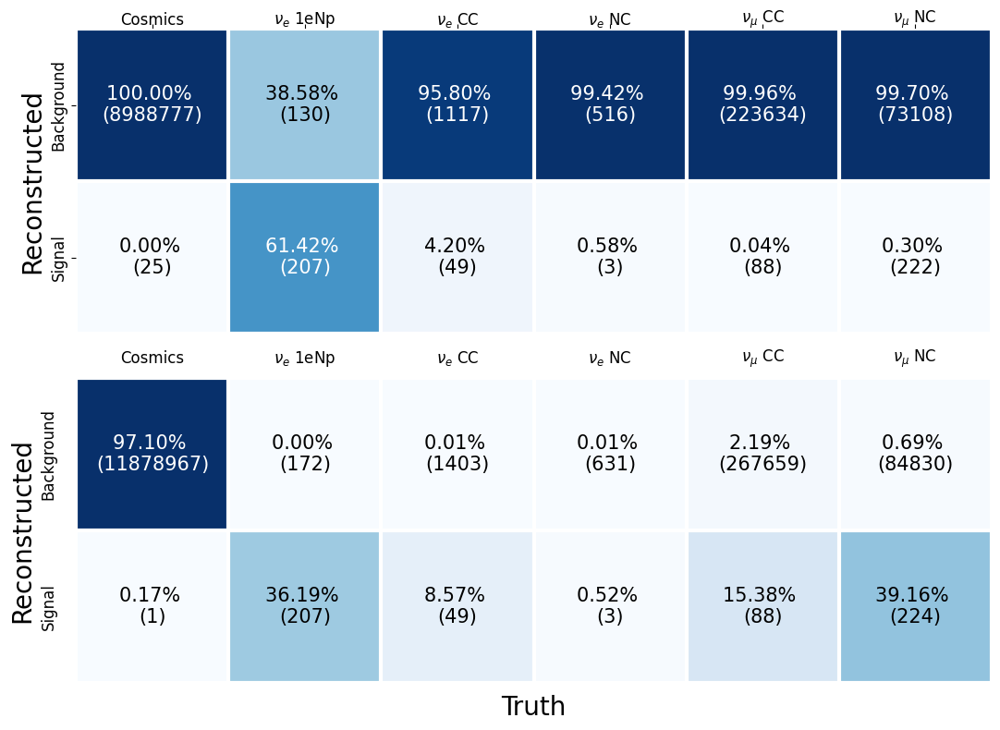

In [42]:
fig, ax = plt.subplots(2, 1, figsize=(12, 8))
im1, text1, _, _, _ = make_confusion_matrix(df_plot, ax=ax[0])
ax[0].set_ylabel('Reconstructed', fontsize=20)
ax[1].set_xlabel('Truth', fontsize=20)
ax[0].set_yticklabels(col_labels, fontsize=12, va='center', rotation=90)
ax[0].set_xticklabels(row_labels, fontsize=12, va='center', rotation =0)

im2, text2, _, _, _ = make_confusion_matrix(df_plot2, ax=ax[1], normalize='pred')
ax[1].set_ylabel('Reconstructed', fontsize=20)
ax[1].set_yticklabels(col_labels, fontsize=12, va='center', rotation=90)
ax[1].set_xticklabels(row_labels, fontsize=12, va='center', rotation =0)

ax[1].tick_params(axis='both', length=0, pad=15)
fig.tight_layout()
# fig.savefig(os.path.join(PLOT_DIR, 'num_final_nocut.pdf'))